In [5]:
from electrode import network
import networkx as nx

# Working with Brain Network graphs

## brain network graphs contain nodes and edges, which can then become neurons and synapses via Electrode or Brian2

## With the Network class you can create a brain graph in two ways: from scratch or from file


### 1. From scratch:

In [7]:
net = network.Network()
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 0
Number of edges: 0



In [8]:
net.add_nodes(['neuron1', 'neuron2', 'neuron3', 'neuron4'])
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 4
Number of edges: 0
Average in degree:   0.0000
Average out degree:   0.0000


In [9]:
#unweighted synapses
net.add_edges([('neuron1', 'neuron2'),('neuron2', 'neuron3'), ('neuron1', 'neuron4')])
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 4
Number of edges: 3
Average in degree:   0.7500
Average out degree:   0.7500


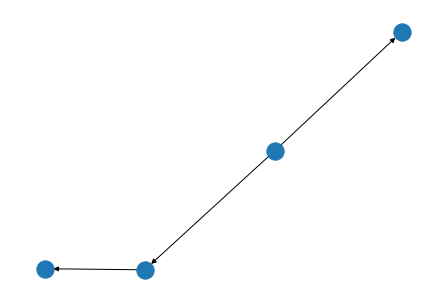

In [10]:
nx.draw(net.graph)

In [11]:
#reset the network to original brain network graph - empty in this case
net.reset()
#weighted synapses
net.add_nodes(['neuron1', 'neuron2', 'neuron3', 'neuron4'])
net.add_weighted_edges([('neuron1', 'neuron2', 1),('neuron2', 'neuron3', .5), ('neuron1', 'neuron4', 2)])
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 4
Number of edges: 3
Average in degree:   0.7500
Average out degree:   0.7500


### 2. From a file

In [12]:
net = network.Network(graph = nx.read_graphml('c_elegans_control.graphml'))
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 397
Number of edges: 5279
Average in degree:  13.2972
Average out degree:  13.2972


# Ablating a graph
### To ablate a graph you need a list of the neuron names


In [13]:
#list the graph nodes to chose from
#print(net.graph.nodes)

In [14]:
net.ablate(['ADAL', 'ADAR'])

In [15]:
#show the graph info of the original non-ablated graph
print(nx.info(net.original_graph))
#show the graph info for the ablated graph, two nodes have been removed
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 397
Number of edges: 5279
Average in degree:  13.2972
Average out degree:  13.2972
Name: 
Type: DiGraph
Number of nodes: 395
Number of edges: 5187
Average in degree:  13.1316
Average out degree:  13.1316


In [16]:
#remove the ablation
net.reset()

In [17]:
print(nx.info(net.original_graph))
print(nx.info(net.graph))

Name: 
Type: DiGraph
Number of nodes: 397
Number of edges: 5279
Average in degree:  13.2972
Average out degree:  13.2972
Name: 
Type: DiGraph
Number of nodes: 397
Number of edges: 5279
Average in degree:  13.2972
Average out degree:  13.2972


### Getting info about the nodes of the graph

In [18]:
network.get_possible_attributes(net)

['SomaPosition',
 'D',
 'type',
 'AYNbr',
 'ky',
 'AYGanglionDesignation',
 'link',
 'group',
 'SomaRegion',
 'outD',
 'name',
 'kx',
 'inD',
 'pos',
 'Dopamine',
 'Gaba',
 'Serotonin',
 'functions',
 'modalities',
 'organ']

In [19]:
network.get_attribute_values(net, 'type')

['inter',
 'sensory',
 'motor',
 'motor, inter',
 'sensory, motor',
 'sensory, inter']

In [20]:
network.get_nodes_by_attribute(net, 'type', 'motor, inter')

['SMDVR',
 'RIVR',
 'SMDVL',
 'AVL',
 'RIVL',
 'RMDL',
 'RMGL',
 'RMHL',
 'SMBDR',
 'RMDR',
 'SMBVL',
 'SMBVR',
 'SMDDR',
 'SMDDL',
 'AVFL',
 'AVFR',
 'PVNR',
 'RMGR',
 'RID',
 'SMBDL',
 'RMDDR',
 'RMDDL',
 'RMHR',
 'DVB',
 'PVNL',
 'RMDVR',
 'RMDVL',
 'RMFR',
 'RMFL']

### Visualizing the brain graphs

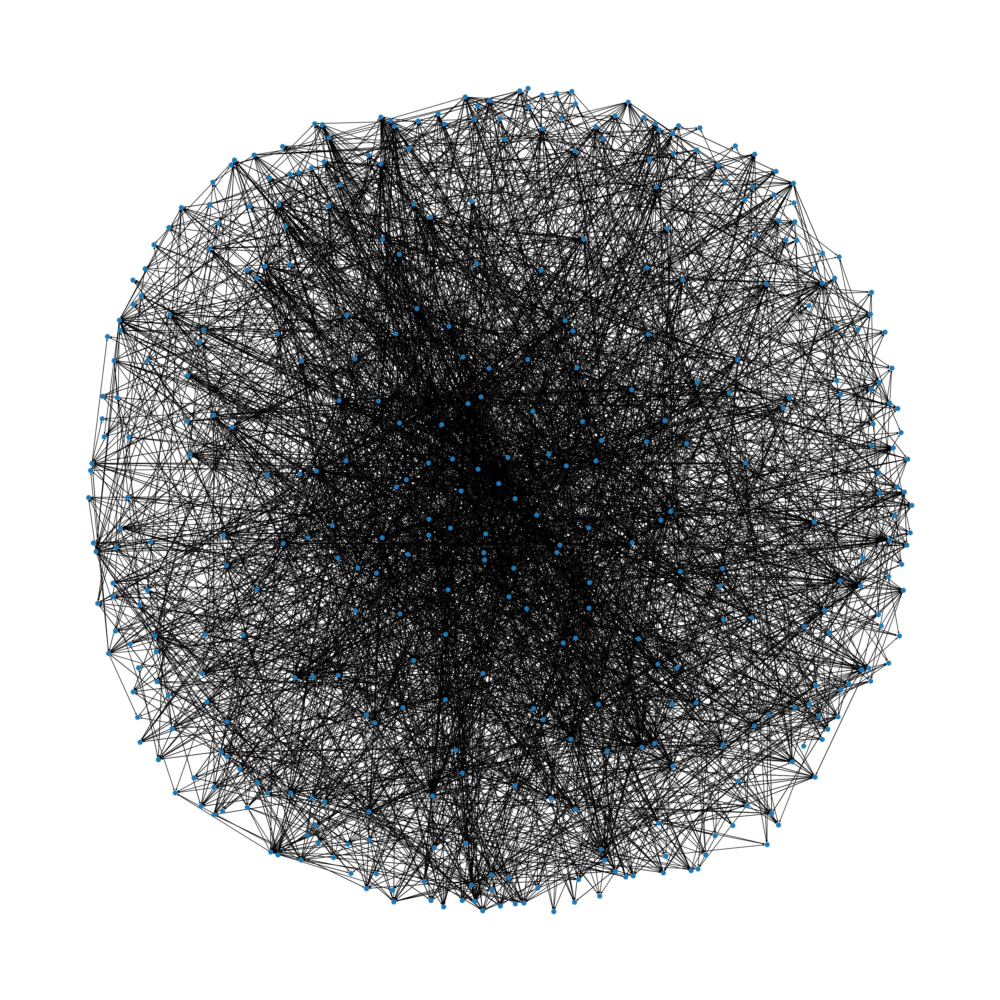

In [21]:
#view the graph
network.view_brain_graph(net)
#network.view_brain_graph_circular(net)

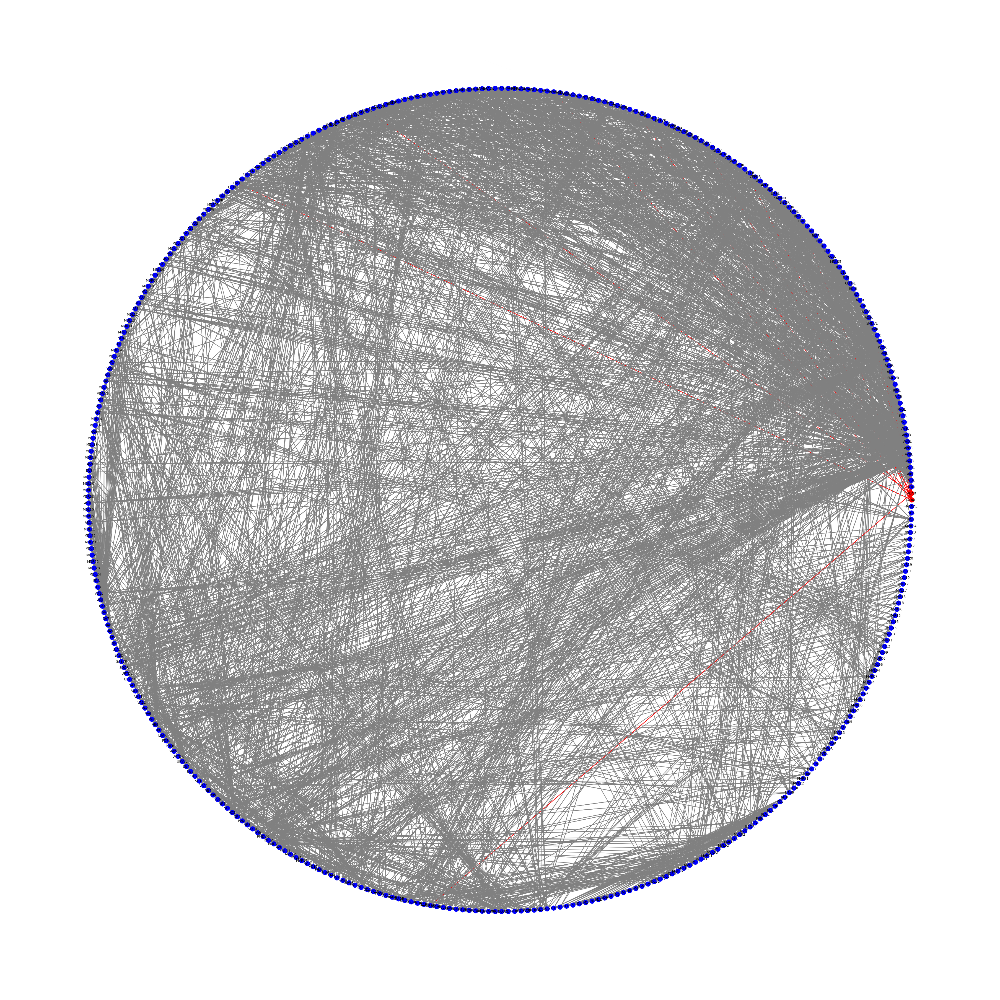

In [22]:
#show what was ablated
net.ablate(['ADAL', 'ADAR'])
network.view_ablated_brain_graph_circular(net)
#network.view_ablated_brain_graph(net)